In [1]:

import random
import os
import glob
import numpy as np # linear algebra
import pandas as pd# data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
import tensorflow as tf
from sklearn.model_selection import train_test_split
from keras.layers import Conv2D, Dense, MaxPool2D, Flatten, Dropout
from keras.models import Sequential
from keras.callbacks import EarlyStopping
from keras.optimizers import Adam
import keras 
import gzip
import pickle

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, multilabel_confusion_matrix
import matplotlib.pyplot as plt

os.chdir('../functions/')
from models import get_class_weight, upsample, preprocessor, plot_confusion_matrix, compile_image_model, \
                    CNN_model,label_dict, revlabel_dict, recreate_labels



# label_dict = {0: 'objects', 1: 'hole', 2: 'oil spot', 3: 'thread error'},
# revlabel_dict = {'objects': 0, 'hole': 1, 'oil spot': 2, 'thread error': 3}

In [2]:
ls -lr ../

total 1208
drwxr-xr-x   3 willtong  staff      96 Jul 31 14:50 tilda_defect_classific/
-rw-r--r--   1 willtong  staff  268760 Jul 31 16:19 tilda-cls-multi.zip
drwxr-xr-x   3 willtong  staff      96 Jul 31 14:50 tests/
-rw-r--r--@  1 willtong  staff     581 Aug  8 13:47 pyproject.toml
-rw-r--r--@  1 willtong  staff  340376 Aug  8 13:47 poetry.lock
drwxr-xr-x  10 willtong  staff     320 Aug  1 10:30 notebooks/
drwxr-xr-x  18 willtong  staff     576 Aug  9 10:29 notebook_CNN/
drwxr-xr-x   6 willtong  staff     192 Aug  9 00:48 functions/
drwxr-xr-x   5 willtong  staff     160 Aug  6 21:04 data/
-rw-r--r--   1 willtong  staff       0 Jul 31 14:48 README.md


In [3]:

DATA_DIR = "../../data/"
large_labels = ["hole", "thread error", "objects", "oil spot"]#, "good"]
# label_scale = [1, 1, 1, 1, 1]

#walk all the files and add them to this
all_files = [filename for filename in glob.glob(DATA_DIR + "//*//*") if 'mono' not in filename]
all_files = [filename for filename in all_files if 'augment' not in filename and 'tilda' not in filename 
             and filename.split("/")[3] in large_labels]


#shuffle
random.shuffle(all_files)


#get class names
all_labels = [filename.split("/")[-2] for filename in all_files]
all_labels_numerical = [revlabel_dict[filename.split("/")[-2]] for filename in all_files]


In [4]:
data_frame = pd.DataFrame()
data_frame["Label"] = all_labels
data_frame["Path"] = all_files
data_frame

,Label,Path
0,objects,../../data/objects/201_patch1-3.png
1,thread error,../../data/thread error/346_patch2-1.png
2,oil spot,../../data/oil spot/075_patch4-1.png
3,oil spot,../../data/oil spot/297_patch4-7.png
4,oil spot,../../data/oil spot/261_patch2-1.png
...,...,...
2425,oil spot,../../data/oil spot/072_patch5-3.png
2426,oil spot,../../data/oil spot/076_patch2-6.png
2427,objects,../../data/objects/371_patch0-2.png
2428,thread error,../../data/thread error/110_patch1-6.png


In [5]:
plt.imread

<function matplotlib.pyplot.imread(fname: 'str | pathlib.Path | BinaryIO', format: 'str | None' = None) -> 'np.ndarray'>

1998
0.4745098 1.0
hole


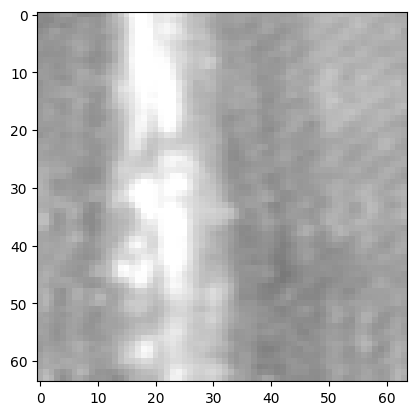

528
0.6117647 0.99215686
hole


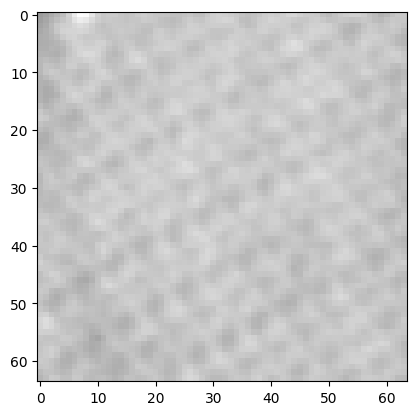

1997
0.5294118 0.92941177
hole


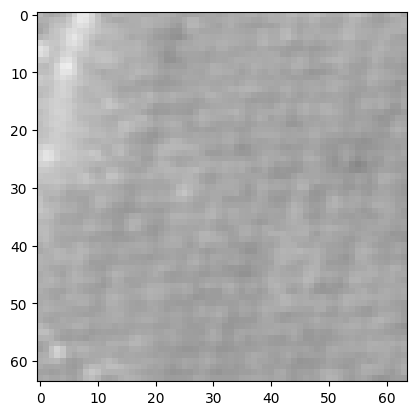

727
0.6 1.0
hole


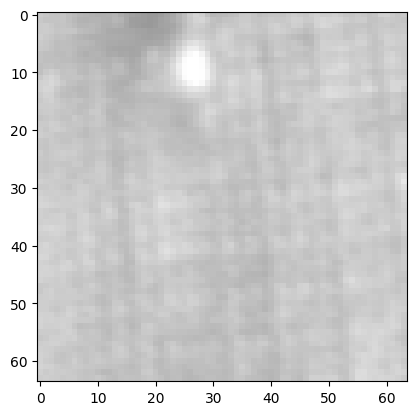

483
0.46666667 0.8156863
hole


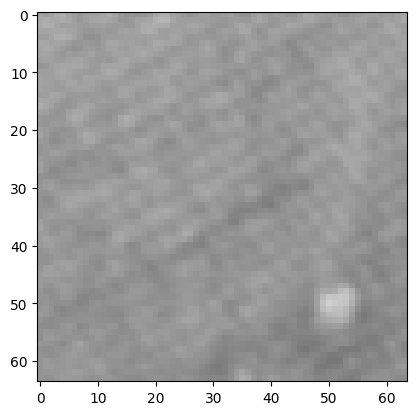

214
0.5764706 1.0
hole


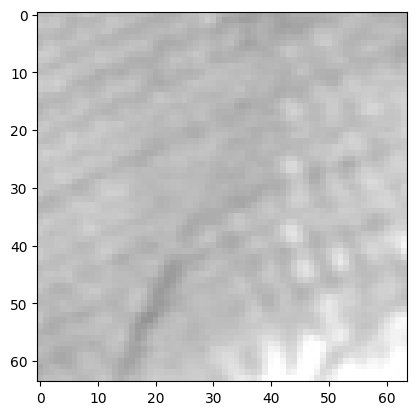

765
0.6627451 1.0
hole


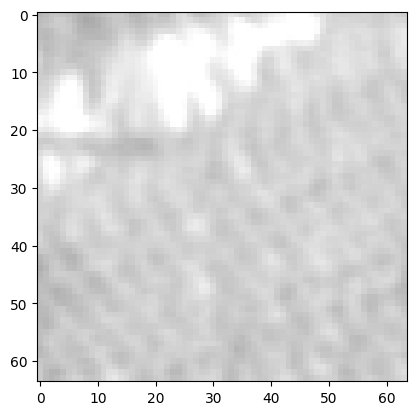

1108
0.56078434 0.9882353
hole


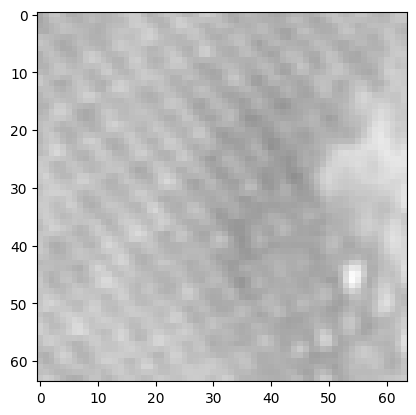

46
0.6117647 0.99215686
hole


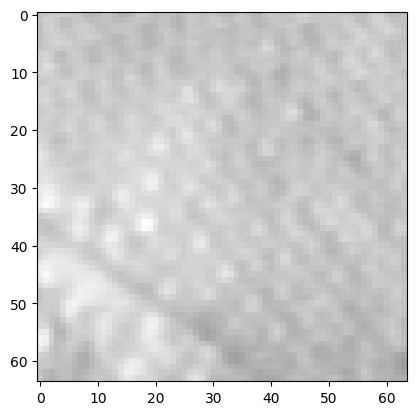

1872
0.6 1.0
hole


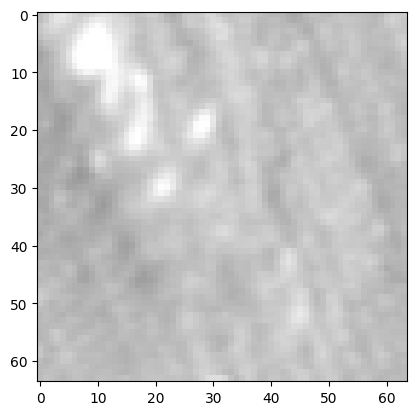

In [6]:
#first see one of the images
for trail in range(100):
    random_sample_number = np.random.randint(data_frame.shape[0])
    if data_frame.iloc[random_sample_number]["Label"] == 'hole':
        print(random_sample_number)
        test_arr = plt.imread(data_frame.iloc[random_sample_number]["Path"])
        print(test_arr.min(), test_arr.max())
        print(data_frame.iloc[random_sample_number]["Label"])
        plt.imshow(test_arr, cmap= 'Greys')
        plt.show()

In [6]:
data_frame.iloc[random_sample_number]["Path"]

NameError: name 'random_sample_number' is not defined

In [7]:
test_arr[:,:,2]

NameError: name 'test_arr' is not defined

<Axes: xlabel='Label', ylabel='count'>

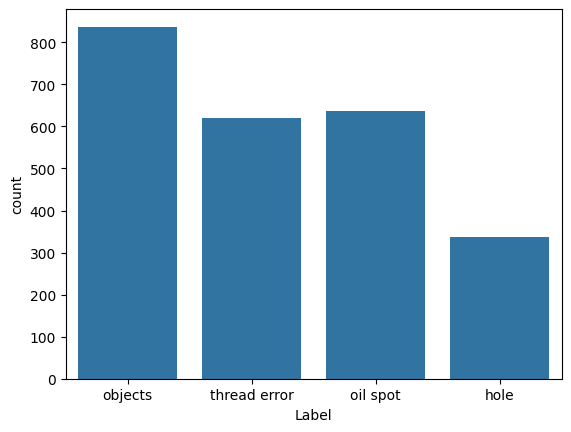

In [8]:
sns.countplot(x = data_frame["Label"]) 

In [9]:
#perform train_test_split
#label encode
# labeller = dict(zip([i for i in balance_df["Label"].unique()], [i for i in range(len(balance_df["Label"].unique()))]))

# rev_labeller = dict(zip([i for i in range(len(balance_df["Label"].unique()))],[i for i in balance_df["Label"].unique()]))
# features = balance_df["Links"]
# label = balance_df["Label"].map(labeller)

features_train, features_eval, labels_train, labels_eval = train_test_split(all_files, all_labels_numerical, stratify=all_labels_numerical, test_size = 0.2, random_state = 11)
features_test, features_eval, labels_test, labels_eval = train_test_split(features_eval, labels_eval, stratify=labels_eval, test_size = 0.5, random_state = 12)


features_train, labels_train, label_upsample_factors =\
    upsample(all_files, revlabel_dict, label_dict, target_samples_per_class = 4000)
features_eval, labels_eval, label_upsample_factors =\
    upsample(all_files, revlabel_dict, label_dict, target_samples_per_class = 500)
# features_test, labels_test, label_upsample_factors =\
#     upsample(all_files, revlabel_dict, label_dict, target_samples_per_class = 2000)

In [10]:
pd.DataFrame(labels_train).value_counts(), pd.DataFrame(labels_eval).value_counts(), pd.DataFrame(labels_test).value_counts()

(0
 0    4185
 1    4044
 2    3816
 3    3720
 Name: count, dtype: int64,
 0
 0    837
 2    636
 3    620
 1    337
 Name: count, dtype: int64,
 0
 0    84
 2    63
 3    62
 1    34
 Name: count, dtype: int64)

In [11]:
class_weights = get_class_weight(labels_train)
class_weights

0.00023894862604540023
0.0002472799208704253
0.0002620545073375262
0.00026881720430107527


{0: 0.00023894862604540023,
 1: 0.0002472799208704253,
 2: 0.0002620545073375262,
 3: 0.00026881720430107527}

In [12]:
pd.DataFrame(labels_train).value_counts(), pd.DataFrame(labels_eval).value_counts()

(0
 0    4185
 1    4044
 2    3816
 3    3720
 Name: count, dtype: int64,
 0
 0    837
 2    636
 3    620
 1    337
 Name: count, dtype: int64)

In [13]:

labels_train = recreate_labels(features_train, revlabel_dict)
labels_eval = recreate_labels(features_eval, revlabel_dict)
labels_test= recreate_labels(features_test, revlabel_dict)

In [14]:
#define dataset objects and preprocessors
features_train_dataset = tf.data.Dataset.from_tensor_slices(features_train)
features_eval_dataset = tf.data.Dataset.from_tensor_slices(features_eval)
features_test_dataset = tf.data.Dataset.from_tensor_slices(features_test)
labels_train_dataset = tf.data.Dataset.from_tensor_slices(labels_train)
labels_eval_dataset = tf.data.Dataset.from_tensor_slices(labels_eval)
labels_test_dataset = tf.data.Dataset.from_tensor_slices(labels_test)


features_train_dataset = features_train_dataset.map(preprocessor)
features_eval_dataset = features_eval_dataset.map(preprocessor)
features_test_dataset = features_test_dataset.map(preprocessor)

train_set = tf.data.Dataset.zip((features_train_dataset, labels_train_dataset))
eval_set = tf.data.Dataset.zip((features_eval_dataset, labels_eval_dataset))
test_set = tf.data.Dataset.zip((features_test_dataset, labels_test_dataset))

train_set = train_set.batch(128).shuffle(128).prefetch(128)
eval_set = eval_set.batch(128).prefetch(128)
test_set = test_set.batch(128).prefetch(128)

In [15]:
np.unique(labels_train, return_counts=True), \
np.unique(labels_eval, return_counts=True), \
np.unique(labels_test, return_counts=True), \
class_weights

((array([0, 1, 2, 3]), array([4185, 4044, 3816, 3720])),
 (array([0, 1, 2, 3]), array([837, 337, 636, 620])),
 (array([0, 1, 2, 3]), array([84, 34, 63, 62])),
 {0: 0.00023894862604540023,
  1: 0.0002472799208704253,
  2: 0.0002620545073375262,
  3: 0.00026881720430107527})

In [16]:

dim =8
conv_factor = 1

<bound method Model.summary of <Sequential name=sequential_1, built=False>>
Epoch 1/100000
124/124 ━━━━━━━━━━━━━━━━━━━━ 115s 919ms/step - accuracy: 0.2697 - loss: 3.6187e-04 - val_accuracy: 0.3041 - val_loss: 1.3869
Epoch 2/100000
124/124 ━━━━━━━━━━━━━━━━━━━━ 115s 922ms/step - accuracy: 0.3012 - loss: 3.4739e-04 - val_accuracy: 0.2947 - val_loss: 1.3831
Epoch 3/100000
124/124 ━━━━━━━━━━━━━━━━━━━━ 114s 918ms/step - accuracy: 0.3181 - loss: 3.4313e-04 - val_accuracy: 0.3012 - val_loss: 1.3578
Epoch 4/100000
124/124 ━━━━━━━━━━━━━━━━━━━━ 114s 917ms/step - accuracy: 0.3393 - loss: 3.4029e-04 - val_accuracy: 0.2992 - val_loss: 1.3485
Epoch 5/100000
124/124 ━━━━━━━━━━━━━━━━━━━━ 115s 921ms/step - accuracy: 0.3374 - loss: 3.3740e-04 - val_accuracy: 0.3626 - val_loss: 1.3162
Epoch 6/100000
124/124 ━━━━━━━━━━━━━━━━━━━━ 114s 914ms/step - accuracy: 0.3592 - loss: 3.3305e-04 - val_accuracy: 0.3560 - val_loss: 1.3144
Epoch 7/100000
124/124 ━━━━━━━━━━━━━━━━━━━━ 115s 924ms/step - accuracy: 0.3634 - los

2024-08-09 09:09:02.118255: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Finished predicting X.
[[17  0  0  0]
 [ 0 47  0  0]
 [ 0  0 39  0]
 [ 0  0  0 25]]


2024-08-09 09:09:02.524519: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


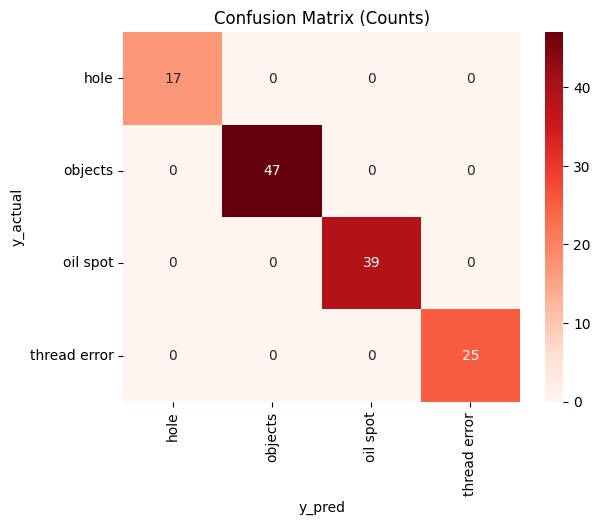

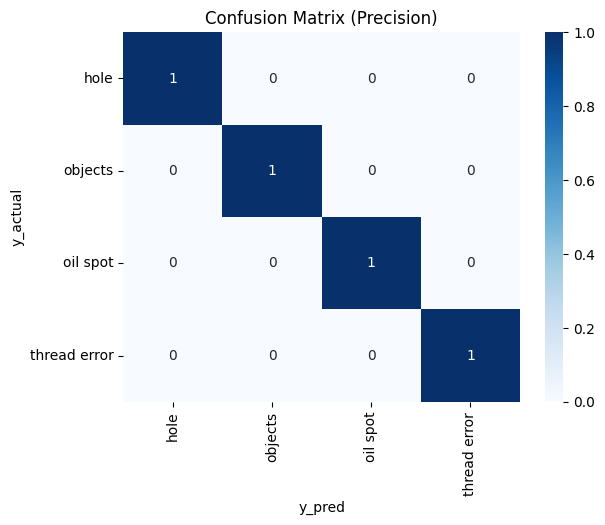

In [18]:

image_model = CNN_model(dim, 0.1, patience = 100, conv_factor = conv_factor, lr = 0.00001, num_classes = 4)
history, image_learner = image_model.fit( train_set, eval_set, label_dict, class_weights=class_weights)


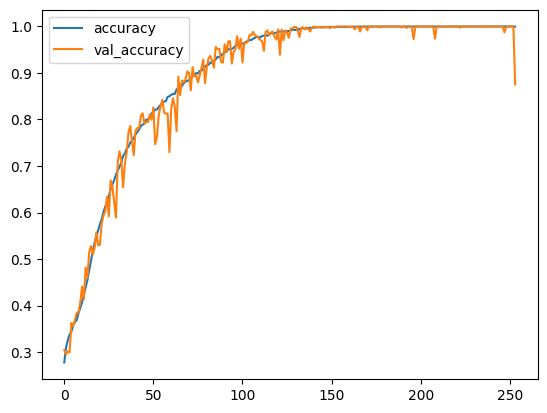

Finished fitting.  Predicting X...
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Finished predicting X.
[[15  0  0  0]
 [ 0 47  0  0]
 [ 0  0 36  0]
 [ 0  0  0 30]]


2024-08-09 09:09:03.067562: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


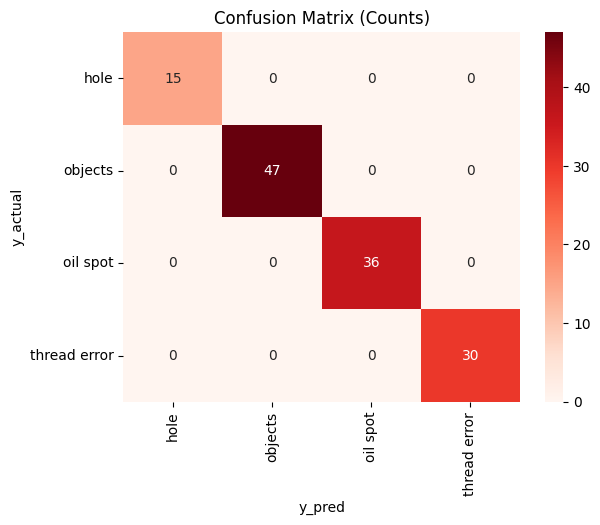

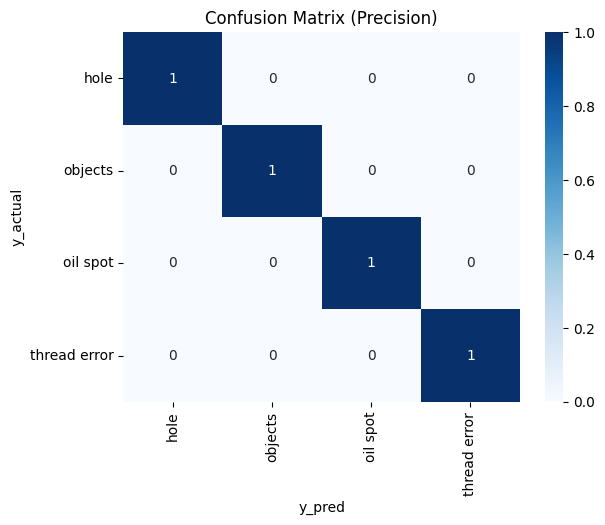

In [19]:
metric = 'accuracy'
plt.plot(history.history[metric], label = metric)
metric = 'val_accuracy'
plt.plot(history.history[metric], label = metric)
plt.legend()
plt.show()
y_predict, y_prob = image_model.predict(test_set)

In [20]:

with gzip.open(f"../data/models/y_prob_{str(dim)}_{str(conv_factor)}.pckl", 'wb') as f:
    pickle.dump(y_prob, f)
with gzip.open(f"../data/models/image_learner_{str(dim)}_{str(conv_factor)}.pckl", 'wb') as f:
    pickle.dump(image_learner, f)
with gzip.open(f"../data/models/history_{str(dim)}_{str(conv_factor)}.pckl", 'wb') as f:
    pickle.dump(history, f)

In [21]:

dim = 8
conv_factor = 1
with gzip.open(f"../data/models/y_prob_{str(dim)}_{str(conv_factor)}.pckl", 'rb') as f:
    y_prob = pickle.load(f)
with gzip.open(f"../data/models/image_learner_{str(dim)}_{str(conv_factor)}.pckl", 'rb') as f:
    image_learner = pickle.load(f)
with gzip.open(f"../data/models/history_{str(dim)}_{str(conv_factor)}.pckl", 'rb') as f:
    history = pickle.load(f)

In [22]:
image_learner.optimizer.learning_rate.numpy()

1e-05

In [23]:
last_layer = image_learner.layers[-1]

In [24]:
last_layer.units

4

In [41]:
image_learner.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)               │ (None, 64, 64, 16)     │         3,088 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 64, 64, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bn0 (BatchNormalization)        │ (None, 64, 64, 16)     │            64 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 64, 64, 32)     │        32,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 32, 32, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 32, 32, 64)     │       131,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 16384)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 8)              │       131,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 4)              │            36 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 894,550 (3.41 MB)

 Trainable params: 298,172 (1.14 MB)

 Non-trainable params: 32 (128.00 B)

 Optimizer params: 596,346 (2.27 MB)

(8, 8, 3, 16)
3 16


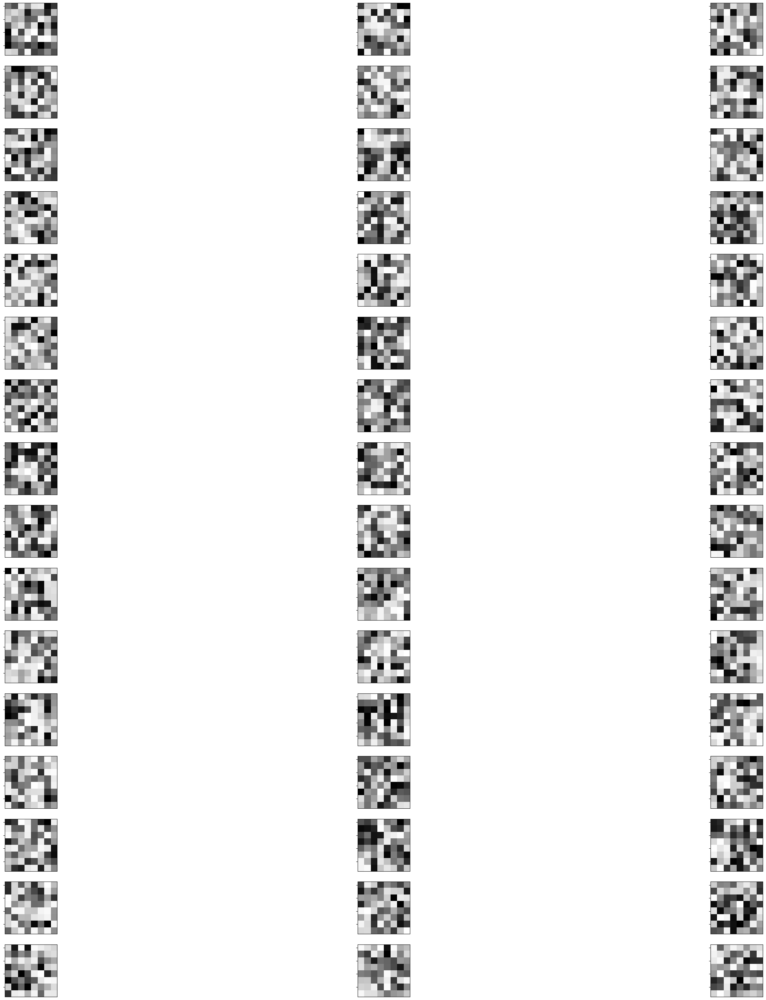

In [40]:
conv2d_16_layer = image_learner.layers[0]
print(conv2d_16_layer.kernel.shape)
num_1 = conv2d_16_layer.kernel.shape[2]
num_2 = conv2d_16_layer.kernel.shape[3]
print(num_1, num_2)
fig, ax = plt.subplots(num_2, num_1, figsize=(40,40))
for j in range(0, num_2):
    for i in range(0, num_1):
        filters_0 = conv2d_16_layer.kernel[:,:,i,j]
        ax[j,i].imshow(filters_0, cmap = 'Greys')
        ax[j,i].set_xticklabels([], fontsize = 0)
        ax[j,i].set_yticklabels([], fontsize = 0)
        ax[j,i].xaxis.set_ticks_position('none') 
        # plt.tick_params(
        # axis='x',          # changes apply to the x-axis
        # which='both',      # both major and minor ticks are affected
        # bottom=False,      # ticks along the bottom edge are off
        # top=False,         # ticks along the top edge are off
        # labelbottom=False) # labels along the bottom edge are off
plt.show()


In [42]:
conv2d_16_layer = image_learner.layers[3]
print(conv2d_16_layer.kernel.shape)
num_1 = conv2d_16_layer.kernel.shape[2]
num_2 = conv2d_16_layer.kernel.shape[3]
print(num_1, num_2)
width = 4
# filters_0 = conv2d_16_layer.kernel[:,:,0,0]
height = int(num_1*num_2/width)
print(f'height, width = {height, width}')
fig, ax = plt.subplots(height, width,  figsize=(500,500))
for sample_number in range(num_1*num_2):
    i = int(sample_number/num_2)
    j = np.remainder(sample_number, num_2) 
    filters_0 = conv2d_16_layer.kernel[:,:,i,j]
    plot_i = int(sample_number/width)
    plot_j = np.remainder(sample_number, width)
    
    ax[plot_i, plot_j].imshow(filters_0, cmap = 'Greys')
    ax[plot_i, plot_j].set_xticklabels([], fontsize = 0)
    ax[plot_i, plot_j].set_yticklabels([], fontsize = 0)
    ax[plot_i, plot_j].xaxis.set_ticks_position('none') 
    plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off
    
print()
plt.show()


(8, 8, 16, 32)
16 32
height, width = (128, 4)



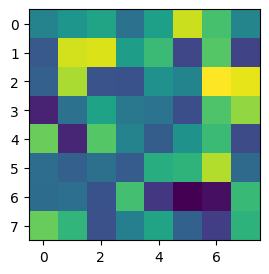

In [38]:
test_arr = filters_0
# print(test_arr.min(), test_arr.max())
# print(data_frame.iloc[random_sample_number]["Label"])
plt.figure(figsize=(3,3))
plt.imshow(filters_0)
plt.show()

In [43]:
conv2d_16_layer = image_learner.layers[3]
print(conv2d_16_layer.kernel.shape)
num_1 = conv2d_16_layer.kernel.shape[2]
num_2 = conv2d_16_layer.kernel.shape[3]
print(num_1, num_2)
width = 4
height = int(num_1*num_2/width/64)
print(f'height, width = {height, width}')
fig, ax = plt.subplots(height, width,  figsize=(500,500))
for sample_number in range(int(num_1*num_2/64)):
    i = int(sample_number/num_2)
    j = np.remainder(sample_number, num_2) 
    filters_0 = conv2d_16_layer.kernel[:,:,i,j]
    plot_i = int(sample_number/width)
    plot_j = np.remainder(sample_number, width)
    
    ax[plot_i, plot_j].imshow(filters_0, cmap = 'Greys')
    ax[plot_i, plot_j].set_xticklabels([], fontsize = 0)
    ax[plot_i, plot_j].set_yticklabels([], fontsize = 0)
    ax[plot_i, plot_j].xaxis.set_ticks_position('none') 
    plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off
plt.tight_layout()    
print()
plt.show()


(8, 8, 16, 32)
16 32
height, width = (2, 4)



In [44]:

conv2d_16_layer = image_learner.layers[6]
print(conv2d_16_layer.kernel.shape)
num_1 = conv2d_16_layer.kernel.shape[2]
num_2 = conv2d_16_layer.kernel.shape[3]
print(num_1, num_2)
width = 4
height = int(num_1*num_2/width/64)
print(f'height, width = {height, width}')
fig, ax = plt.subplots(height, width,  figsize=(500,500))
for sample_number in range(int(num_1*num_2/64)):
    i = int(sample_number/num_2)
    j = np.remainder(sample_number, num_2) 
    filters_0 = conv2d_16_layer.kernel[:,:,i,j]
    plot_i = int(sample_number/width)
    plot_j = np.remainder(sample_number, width)
    
    ax[plot_i, plot_j].imshow(filters_0, cmap = 'Greys')
    ax[plot_i, plot_j].set_xticklabels([], fontsize = 0)
    ax[plot_i, plot_j].set_yticklabels([], fontsize = 0)
    ax[plot_i, plot_j].xaxis.set_ticks_position('none') 
    plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off
plt.tight_layout()    
print()
plt.show()


(8, 8, 32, 64)
32 64
height, width = (8, 4)

